# How machine learning and natural language processing can help us understand the European energy crisis and the labor market through social media.


The news source has shifted to social media, which has given us an advantage to figure out the future trends sooner and make better decisions. Analyzing social media like Twitter would help us identify these trends earlier so that we can take action to avoid or mitigate them.
This is especially important in the current climate, where the future is uncertain and the ability to make quick, informed decisions is critical. Social media analysis can help us make better decisions about where to allocate resources, how to respond to events, and what policies to put in place.
In the past, we would have to wait for news reports to come out about events that had already happened. With social media, we can see what is happening in real-time and make decisions accordingly. This allows us to be more proactive and responsive, and ultimately, to better protect our interests.

In this blog post, we want to use modern machine learning and NLP tools to analyze the relationship between the energy crisis and the workforce situation through twitter data. We'll see how these tools will help us to identify the important trends and extract important topics to focus on to form better decisions.

We'll also use time series analysis tools to be able to identify the changes in trends over time automatically which can a be great tool to gain positive advantage and get ahead of the competition.


The first step is to collect relevant data. We will use our custom twitter API which has several advantages over the standard Twitter API. The main benefit is that we don't have time restrictions on the data we can collect. This means that we can collect as much data as we want, and we can collect it over a longer period of time. This is important because we want to be able to analyze trends over time. it also includes preprocessing and cleaning the data which make it much easier to work with and apply machine learning tools on it.

In this blog post we'll get the tweets about the "Europe's energy crisis" and "workforce situation" from "2022-06-01" until "2022-09-15" and analyze them to see how they are related to each other. Our twitter API gives us the preprocessed tweets along with the sentiment associated with each tweet. this will make our job much easier and we can focus on the analysis part.

In the API backend we use the state of the art transformers based NLP tools to calculate the sentiment of each tweet or extract important entities and the sentiment associated with them. 

## Install

In [122]:
import re
import pandas as pd
from datetime import datetime
import tweepy    
import datetime
import matplotlib.pyplot as plt
import seaborn as sns

## Preprocessing the data

Here we read the two csv files containing the tweets and the associated information for the two topics. we can see the columns and sample data below.

In [92]:
europe_df = pd.read_csv('eroupe-energy-tweets-sentiment.csv')
workforce_df = pd.read_csv('workforce-tweets-sentiment.csv')

In [93]:
len(europe_df), len(workforce_df)

(126623, 200001)

In [14]:
europe_df.tail()

,Datetime,Tweet Id,Text,Username,sentiment_score,sentiment_label
126618,2022-06-01 00:14:19+00:00,1531791216589041665,"SBSNews Europe does not care about Ukraine, th...",mark555888999,0.998791,NEGATIVE
126619,2022-06-01 00:12:57+00:00,1531790868960755712,Oil Prices Surpass per Barrel as Europe Consid...,Ian_inform,0.905187,NEGATIVE
126620,2022-06-01 00:11:33+00:00,1531790516181950467,Russia’s Gazprom halts gas supplies to Denmark...,G_Old_M,0.999523,NEGATIVE
126621,2022-06-01 00:10:44+00:00,1531790313689341952,And now of course we have a lack of gas and en...,patrick_pulley,0.997535,NEGATIVE
126622,2022-06-01 00:07:24+00:00,1531789472458854402,Der russische StaatskonzernGazprom wirdShell E...,nachrichten_at,0.960392,NEGATIVE


In [108]:
## concatenate the two dataframes with a new column to indicate the source dataframe

europe_df['source'] = 'europe'
workforce_df['source'] = 'workforce'

tweets_df = pd.concat([europe_df, workforce_df], ignore_index=True)
tweets_df.tail()


,Datetime,Tweet Id,Text,Username,sentiment_score,sentiment_label,source
326619,2022-07-20 09:29:33+00:00,1549687947242479616,How marketers are adapting to the new world of...,vsnamsterdam,0.994456,POSITIVE,workforce
326620,2022-07-20 09:29:13+00:00,1549687863033430016,"With insight fromMJThoro,TransportHelen,ming_a...",Dr_jrwells,0.983068,POSITIVE,workforce
326621,2022-07-20 09:28:41+00:00,1549687730438737920,nhs_pensions: of a payroll date in October tha...,KimKimW3,0.997610,NEGATIVE,workforce
326622,2022-07-20 09:28:23+00:00,1549687653880446976,All-in-one Human Resource Management System th...,BatchMasterHeRd,0.996492,POSITIVE,workforce
326623,2022-07-20 09:27:22+00:00,1549687398929408000,"Without seed dispersal from birds, we could wa...",Natures_Voice,0.950766,POSITIVE,workforce


In [109]:

tweets_df = tweets_df.sort_values(by='Datetime')
europe_df = europe_df.sort_values(by='Datetime')
workforce_df = workforce_df.sort_values(by='Datetime')


In [111]:
len(tweets_df),len(europe_df),len(workforce_df)

(326624, 126623, 200001)

In [112]:
## remove every row that has a null value

tweets_df = tweets_df.dropna()
europe_df = europe_df.dropna()
workforce_df = workforce_df.dropna()
len(tweets_df)

326510

In [101]:
tweets_df.head()

,Datetime,Tweet Id,Text,Username,sentiment_score,sentiment_label,source
126622,2022-06-01 00:07:24+00:00,1531789472458854402,Der russische StaatskonzernGazprom wirdShell E...,nachrichten_at,0.960392,NEGATIVE,europe
126621,2022-06-01 00:10:44+00:00,1531790313689341952,And now of course we have a lack of gas and en...,patrick_pulley,0.997535,NEGATIVE,europe
126620,2022-06-01 00:11:33+00:00,1531790516181950467,Russia’s Gazprom halts gas supplies to Denmark...,G_Old_M,0.999523,NEGATIVE,europe
126619,2022-06-01 00:12:57+00:00,1531790868960755712,Oil Prices Surpass per Barrel as Europe Consid...,Ian_inform,0.905187,NEGATIVE,europe
126618,2022-06-01 00:14:19+00:00,1531791216589041665,"SBSNews Europe does not care about Ukraine, th...",mark555888999,0.998791,NEGATIVE,europe


In [113]:
## Convert Datetime column to datetime format

tweets_df['Datetime'] = pd.to_datetime(tweets_df['Datetime'])
europe_df['Datetime'] = pd.to_datetime(europe_df['Datetime'])
workforce_df['Datetime'] = pd.to_datetime(workforce_df['Datetime'])
tweets_df.head()

,Datetime,Tweet Id,Text,Username,sentiment_score,sentiment_label,source
126622,2022-06-01 00:07:24+00:00,1531789472458854402,Der russische StaatskonzernGazprom wirdShell E...,nachrichten_at,0.960392,NEGATIVE,europe
126621,2022-06-01 00:10:44+00:00,1531790313689341952,And now of course we have a lack of gas and en...,patrick_pulley,0.997535,NEGATIVE,europe
126620,2022-06-01 00:11:33+00:00,1531790516181950467,Russia’s Gazprom halts gas supplies to Denmark...,G_Old_M,0.999523,NEGATIVE,europe
126619,2022-06-01 00:12:57+00:00,1531790868960755712,Oil Prices Surpass per Barrel as Europe Consid...,Ian_inform,0.905187,NEGATIVE,europe
126618,2022-06-01 00:14:19+00:00,1531791216589041665,"SBSNews Europe does not care about Ukraine, th...",mark555888999,0.998791,NEGATIVE,europe


In [114]:
## Add year, month, day, hour, minute to the dataframe

tweets_df['created_at_minute'] = tweets_df['Datetime'].apply(lambda x: x.minute)
tweets_df['created_at_hour'] = tweets_df['Datetime'].apply(lambda x: x.hour)
tweets_df['created_at_day'] = tweets_df['Datetime'].apply(lambda x: x.day)
tweets_df['created_at_month'] = tweets_df['Datetime'].apply(lambda x: x.month)
tweets_df['created_at_year'] = tweets_df['Datetime'].apply(lambda x: x.year)

europe_df['created_at_minute'] = europe_df['Datetime'].apply(lambda x: x.minute)
europe_df['created_at_hour'] = europe_df['Datetime'].apply(lambda x: x.hour)
europe_df['created_at_day'] = europe_df['Datetime'].apply(lambda x: x.day)
europe_df['created_at_month'] = europe_df['Datetime'].apply(lambda x: x.month)
europe_df['created_at_year'] = europe_df['Datetime'].apply(lambda x: x.year)

workforce_df['created_at_minute'] = workforce_df['Datetime'].apply(lambda x: x.minute)
workforce_df['created_at_hour'] = workforce_df['Datetime'].apply(lambda x: x.hour)
workforce_df['created_at_day'] = workforce_df['Datetime'].apply(lambda x: x.day)
workforce_df['created_at_month'] = workforce_df['Datetime'].apply(lambda x: x.month)
workforce_df['created_at_year'] = workforce_df['Datetime'].apply(lambda x: x.year)


tweets_df.head()

,Datetime,Tweet Id,Text,Username,sentiment_score,sentiment_label,source,created_at_minute,created_at_hour,created_at_day,created_at_month,created_at_year
126622,2022-06-01 00:07:24+00:00,1531789472458854402,Der russische StaatskonzernGazprom wirdShell E...,nachrichten_at,0.960392,NEGATIVE,europe,7,0,1,6,2022
126621,2022-06-01 00:10:44+00:00,1531790313689341952,And now of course we have a lack of gas and en...,patrick_pulley,0.997535,NEGATIVE,europe,10,0,1,6,2022
126620,2022-06-01 00:11:33+00:00,1531790516181950467,Russia’s Gazprom halts gas supplies to Denmark...,G_Old_M,0.999523,NEGATIVE,europe,11,0,1,6,2022
126619,2022-06-01 00:12:57+00:00,1531790868960755712,Oil Prices Surpass per Barrel as Europe Consid...,Ian_inform,0.905187,NEGATIVE,europe,12,0,1,6,2022
126618,2022-06-01 00:14:19+00:00,1531791216589041665,"SBSNews Europe does not care about Ukraine, th...",mark555888999,0.998791,NEGATIVE,europe,14,0,1,6,2022


In [115]:
## Add positive and negetive coulmns to the dataframe from the sentiment_label column

tweets_df['positive'] = tweets_df['sentiment_label'].apply(lambda x: 1 if x == 'POSITIVE' else 0)
tweets_df['negative'] = tweets_df['sentiment_label'].apply(lambda x: 1 if x == 'NEGATIVE' else 0)

europe_df['positive'] = europe_df['sentiment_label'].apply(lambda x: 1 if x == 'POSITIVE' else 0)
europe_df['negative'] = europe_df['sentiment_label'].apply(lambda x: 1 if x == 'NEGATIVE' else 0)

workforce_df['positive'] = workforce_df['sentiment_label'].apply(lambda x: 1 if x == 'POSITIVE' else 0)
workforce_df['negative'] = workforce_df['sentiment_label'].apply(lambda x: 1 if x == 'NEGATIVE' else 0)

## Add positve score and negetive score columns to the dataframe from the sentiment_score column
## if the tweet is positive, the positive score is the sentiment score and the negetive score is 1 - sentiment score
## if the tweet is negetive, the negetive score is the sentiment score and the positive score is 1 - sentiment score

tweets_df['positive_score'] = tweets_df.apply(lambda x: x['sentiment_score'] if x['sentiment_label'] == 'POSITIVE' else 1 - x['sentiment_score'], axis=1)
tweets_df['negative_score'] = tweets_df.apply(lambda x: x['sentiment_score'] if x['sentiment_label'] == 'NEGATIVE' else 1 - x['sentiment_score'], axis=1)

europe_df['positive_score'] = europe_df.apply(lambda x: x['sentiment_score'] if x['sentiment_label'] == 'POSITIVE' else 1 - x['sentiment_score'], axis=1)
europe_df['negative_score'] = europe_df.apply(lambda x: x['sentiment_score'] if x['sentiment_label'] == 'NEGATIVE' else 1 - x['sentiment_score'], axis=1)

workforce_df['positive_score'] = workforce_df.apply(lambda x: x['sentiment_score'] if x['sentiment_label'] == 'POSITIVE' else 1 - x['sentiment_score'], axis=1)
workforce_df['negative_score'] = workforce_df.apply(lambda x: x['sentiment_score'] if x['sentiment_label'] == 'NEGATIVE' else 1 - x['sentiment_score'], axis=1)

tweets_df.head()

,Datetime,Tweet Id,Text,Username,sentiment_score,sentiment_label,source,created_at_minute,created_at_hour,created_at_day,created_at_month,created_at_year,positive,negative,positive_score,negative_score
126622,2022-06-01 00:07:24+00:00,1531789472458854402,Der russische StaatskonzernGazprom wirdShell E...,nachrichten_at,0.960392,NEGATIVE,europe,7,0,1,6,2022,0,1,0.039608,0.960392
126621,2022-06-01 00:10:44+00:00,1531790313689341952,And now of course we have a lack of gas and en...,patrick_pulley,0.997535,NEGATIVE,europe,10,0,1,6,2022,0,1,0.002465,0.997535
126620,2022-06-01 00:11:33+00:00,1531790516181950467,Russia’s Gazprom halts gas supplies to Denmark...,G_Old_M,0.999523,NEGATIVE,europe,11,0,1,6,2022,0,1,0.000477,0.999523
126619,2022-06-01 00:12:57+00:00,1531790868960755712,Oil Prices Surpass per Barrel as Europe Consid...,Ian_inform,0.905187,NEGATIVE,europe,12,0,1,6,2022,0,1,0.094813,0.905187
126618,2022-06-01 00:14:19+00:00,1531791216589041665,"SBSNews Europe does not care about Ukraine, th...",mark555888999,0.998791,NEGATIVE,europe,14,0,1,6,2022,0,1,0.001209,0.998791


To makeit easier to work with the data, we'll avaerage the sentiment for each hour in the positive_score and negative_score columns.

In [116]:
## New dataframe with columns: average of positive sentiment, average of negative sentiment, count of tweets for each hour

tweets_df_avg = tweets_df.groupby(['created_at_year', 'created_at_month', 'created_at_day', 'created_at_hour']).agg({'positive_score': 'mean', 'negative_score': 'mean', 'Text': 'count'}).reset_index()
europe_df_avg = europe_df.groupby(['created_at_year', 'created_at_month', 'created_at_day', 'created_at_hour']).agg({'positive_score': 'mean', 'negative_score': 'mean', 'Text': 'count'}).reset_index()
workforce_df_avg = workforce_df.groupby(['created_at_year', 'created_at_month', 'created_at_day', 'created_at_hour']).agg({'positive_score': 'mean', 'negative_score': 'mean', 'Text': 'count'}).reset_index()

workforce_df_avg.head()


,created_at_year,created_at_month,created_at_day,created_at_hour,positive_score,negative_score,Text
0,2022,7,20,9,0.478394,0.521606,67
1,2022,7,20,10,0.517780,0.482220,150
2,2022,7,20,11,0.433315,0.566685,154
3,2022,7,20,12,0.496263,0.503737,240
4,2022,7,20,13,0.535573,0.464427,255


Our new dataframe becomes smaller and easier to work with and visualize.

In [117]:
len(tweets_df_avg), len(europe_df_avg), len(workforce_df_avg)

(2544, 2544, 1359)

In [121]:
## Adding the date column to the dataframe

tweets_df_avg['date'] = tweets_df_avg.apply(lambda x: datetime.datetime(int(x['created_at_year']), int(x['created_at_month']), int(x['created_at_day']), int(x['created_at_hour'])), axis=1)
europe_df_avg['date'] = europe_df_avg.apply(lambda x: datetime.datetime(int(x['created_at_year']), int(x['created_at_month']), int(x['created_at_day']), int(x['created_at_hour'])), axis=1)
workforce_df_avg['date'] = workforce_df_avg.apply(lambda x: datetime.datetime(int(x['created_at_year']), int(x['created_at_month']), int(x['created_at_day']), int(x['created_at_hour'])), axis=1)

europe_df_avg.head()


,created_at_year,created_at_month,created_at_day,created_at_hour,positive_score,negative_score,Text,date
0,2022,6,1,0,0.227996,0.772004,33,2022-06-01 00:00:00
1,2022,6,1,1,0.174377,0.825623,23,2022-06-01 01:00:00
2,2022,6,1,2,0.071023,0.928977,17,2022-06-01 02:00:00
3,2022,6,1,3,0.268706,0.731294,13,2022-06-01 03:00:00
4,2022,6,1,4,0.058884,0.941116,12,2022-06-01 04:00:00


In [41]:
tweets_df_avg.head()

,created_at_year,created_at_month,created_at_day,created_at_hour,positive_score,negative_score,Text,date
0,2022,6,1,0,0.227996,0.772004,33,2022-06-01 00:00:00
1,2022,6,1,1,0.174377,0.825623,23,2022-06-01 01:00:00
2,2022,6,1,2,0.071023,0.928977,17,2022-06-01 02:00:00
3,2022,6,1,3,0.268706,0.731294,13,2022-06-01 03:00:00
4,2022,6,1,4,0.058884,0.941116,12,2022-06-01 04:00:00


Let's plot the average sentiment of each hour for both topics. 

In [125]:
## Plot the average of positive sentiment of europe_df_avg and workforce_df_avg for each hour in the same plot with different colors in plotly

fig = go.Figure()
fig.add_trace(go.Scatter(x=europe_df_avg['date'], y=europe_df_avg['positive_score'], name='positive_score_europe',
                            line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=workforce_df_avg['date'], y=workforce_df_avg['positive_score'], name='positive_score_workforce',
                            line=dict(color='royalblue', width=4))) 
fig.update_layout(title='Average of positive sentiment for each hour',  
                    xaxis_title='Date', 
                    yaxis_title='Positive sentiment')
fig.show()

As tou see above, our sample dataset does't contain data before June 20th. we'll just going to ignore this for now and focus on the rest of the data. from the plot we can already see the changes of the sentiment over time and it seems that the workforce situation data on twitter is a bit more positive than the energy crisis data overally. it's a good start but we can clean the plot a bit more to make it easier to read.

Here we use rolling average with a window of 10 to create a smoother plot.

In [126]:
## smooth the data

tweets_df_avg['positive_score_smooth'] = tweets_df_avg['positive_score'].rolling(window=10).mean()
tweets_df_avg['negative_score_smooth'] = tweets_df_avg['negative_score'].rolling(window=10).mean()
tweets_df_avg['Text_smooth'] = tweets_df_avg['Text'].rolling(window=10).mean()

europe_df_avg['positive_score_smooth'] = europe_df_avg['positive_score'].rolling(window=10).mean()
europe_df_avg['negative_score_smooth'] = europe_df_avg['negative_score'].rolling(window=10).mean()
europe_df_avg['Text_smooth'] = europe_df_avg['Text'].rolling(window=10).mean()

workforce_df_avg['positive_score_smooth'] = workforce_df_avg['positive_score'].rolling(window=10).mean()
workforce_df_avg['negative_score_smooth'] = workforce_df_avg['negative_score'].rolling(window=10).mean()
workforce_df_avg['Text_smooth'] = workforce_df_avg['Text'].rolling(window=10).mean()



Let's plot the smoothed data for both topics on the same plot to see how they are related to each other.

In [127]:
## Plotting the smoothed positive sentiment data for europe_df_avg and workforce_df_avg for each hour in the same plot with different colors in plotly

fig = go.Figure()
fig.add_trace(go.Scatter(x=europe_df_avg['date'], y=europe_df_avg['positive_score_smooth'], name='positive_score_europe',
                            line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=workforce_df_avg['date'], y=workforce_df_avg['positive_score_smooth'], name='positive_score_workforce',
                            line=dict(color='royalblue', width=4)))
fig.update_layout(title='Average of positive sentiment for each hour',
                    xaxis_title='Date', 
                    yaxis_title='Positive sentiment')
fig.show()


From The chart above we can see more clearly that how the avergae sentiment of the workforce situation data is more positive than the energy crisis data. We can also see that there seems to be a correlation between the two topics in terms of how sentiment scores of the tweets. these data can be helpful for experts to make better decisions and take actions to avoid or mitigate the problems.

Now let's also plot the number of tweets for each topic over time to see how they are related to each other.
again we're using the smoothed data to make it easier to read.

It's visible that rate of tweets about europe's energy crisis is steady until about last week of August 2022 and then we can see an increase in number of tweets about the topic. It's also interesting to note the weekly pattern of number of tweets about the workforce situation

In [129]:
## Plotting the smoothed text data for tweets_df_avg, europe_df_avg and workforce_df_avg for each hour in the same plot with different colors in plotly

fig = go.Figure()
fig.add_trace(go.Scatter(x=europe_df_avg['date'], y=europe_df_avg['Text_smooth'], name='europe',
                            line=dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=workforce_df_avg['date'], y=workforce_df_avg['Text_smooth'], name='workforce',
                            line=dict(color='green', width=4)))
fig.update_layout(title='Count of tweets for each hour',        
                    xaxis_title='Date',
                    yaxis_title='Count of tweets')
fig.show()

In [130]:
tweets_df_avg.to_csv('tweets_df_avg.csv', sep=',', index=False)
europe_df_avg.to_csv('europe_df_avg.csv', sep=',', index=False)
workforce_df_avg.to_csv('workforce_df_avg.csv', sep=',', index=False)


## Time series analysis

In the previous section we saw ho the sentiment about thus two topics have changed over a period of time and how there might be a correlatio between the two. Now we want to see if we can automate the process of identifying the changes in sentiment over time. We'll use time series analysis tools to do this. It can be a great tool for buisness to get noified automatically when there is a change in sentiment towards a specific topic and take action accordingly.

we will employ a few time series analysis techniques. We will use Meta’s Kats library which offers a range of time series analysis tools.

In [ ]:
import kats
import numpy as np
import logging
from imp import reload
from datetime import datetime, timedelta
import pandas as pd
import sys
import os
from kats.consts import TimeSeriesData
import matplotlib.pyplot as plt
reload(logging)

In [2]:
from kats.detectors.bocpd import BOCPDetector, BOCPDModelType, TrendChangeParameters
from kats.consts import TimeSeriesData
from kats.utils.decomposition import TimeSeriesDecomposition
from kats.detectors.cusum_detection import CUSUMDetector
from kats.detectors.robust_stat_detection import RobustStatDetector


In [3]:
tweets_df_avg = pd.read_csv('europe_df_avg.csv')
tweets_df_avg.head()

,created_at_year,created_at_month,created_at_day,created_at_hour,positive_score,negative_score,Text,date,positive_score_smooth,negative_score_smooth,Text_smooth
0,2022,6,1,0,0.227996,0.772004,33,2022-06-01 00:00:00,NaN,NaN,NaN
1,2022,6,1,1,0.174377,0.825623,23,2022-06-01 01:00:00,NaN,NaN,NaN
2,2022,6,1,2,0.071023,0.928977,17,2022-06-01 02:00:00,NaN,NaN,NaN
3,2022,6,1,3,0.268706,0.731294,13,2022-06-01 03:00:00,NaN,NaN,NaN
4,2022,6,1,4,0.058884,0.941116,12,2022-06-01 04:00:00,NaN,NaN,NaN


In [4]:
type(tweets_df_avg.Text_smooth)

pandas.core.series.Series

In [5]:
tweets_df_avg.isnull().sum()

created_at_year          0
created_at_month         0
created_at_day           0
created_at_hour          0
positive_score           0
negative_score           0
Text                     0
date                     0
positive_score_smooth    9
negative_score_smooth    9
Text_smooth              9
dtype: int64

In [6]:
tweets_df_avg = tweets_df_avg.dropna()
tweets_df_avg.isnull().sum()

created_at_year          0
created_at_month         0
created_at_day           0
created_at_hour          0
positive_score           0
negative_score           0
Text                     0
date                     0
positive_score_smooth    0
negative_score_smooth    0
Text_smooth              0
dtype: int64

First we'll start by preprocessing the data. we have already read the csv data and created a dataframe based on that. we'll use the dataframe to create a time series object. 

In [7]:
tsdata = TimeSeriesData(time_col_name='Timestamp', time= tweets_df_avg.date, value=tweets_df_avg.positive_score_smooth, sort_by_time=True)

In [8]:
tsdata

,date,positive_score_smooth
0,2022-06-01 09:00:00,0.226046
1,2022-06-01 10:00:00,0.223476
2,2022-06-01 11:00:00,0.238697
3,2022-06-01 12:00:00,0.271609
4,2022-06-01 13:00:00,0.281750
...,...,...
2530,2022-09-14 19:00:00,0.362498
2531,2022-09-14 20:00:00,0.355815
2532,2022-09-14 21:00:00,0.338306
2533,2022-09-14 22:00:00,0.325266


Here is a plot of a sample of 500 data points from the time series object.

<AxesSubplot:xlabel='date'>

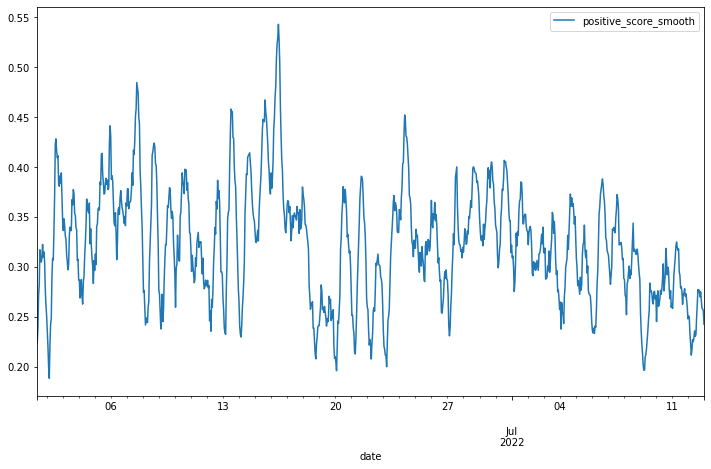

In [20]:
tsdata[:1000].plot()

Next, we'll decompose our time series data, to identify and normalize trends and seasonality in our time series. 
We will apply Kats’ decomposition utility in “additive” mode to each of our time series.

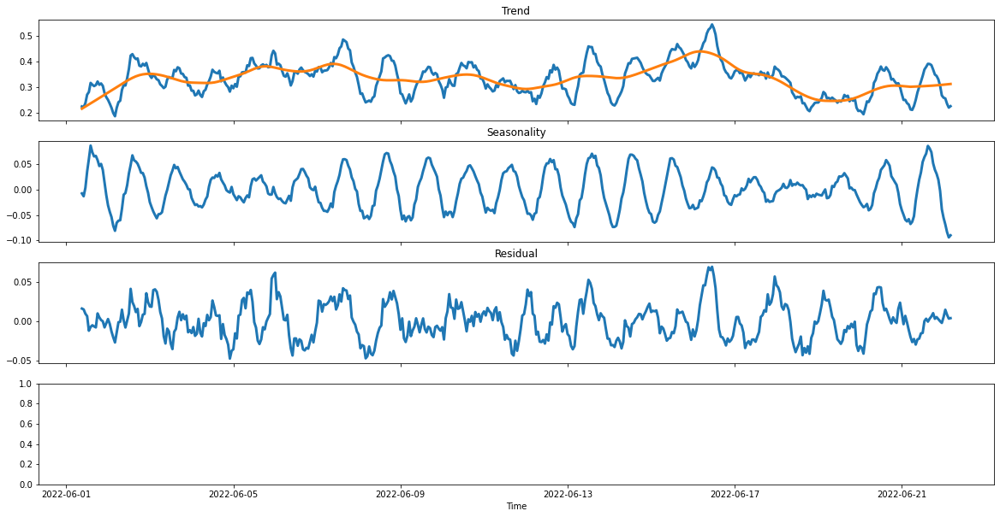

In [10]:
decomposer = TimeSeriesDecomposition(tsdata[:500], decomposition="additive")
decomposed = decomposer.decomposer()
fig = decomposer.plot()

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('whitegrid')

Change point detection

Changepoint detection tries to identify times when the probability distribution of a stochastic process or time series changes, e.g. the change of mean in a time series. It is one of the most popular detection tasks in time series analysis.

CUSUM is a method to detect an up/down shift of means in a time series. Our implementation has two main steps:

Locate the change point: This is an iterative process where we initialize a change point (in the middle of the time series) and CUSUM time series based on this change point. The next changepoint is the location where the previous CUSUM time series is maximized (or minimized). This iteration continues until either:
1) a stable changepoint is found or
2) we exceed the limit number of iterations.
Test the change point for statistical significance: Conduct log likelihood ratio test to test if the mean of the time series changes at the changepoint calculated in Step 1. The null hypothesis is that there is no change in mean.
By default, we report a detected changepoint if and only if we reject the null hypothesis in Step 2. If we want to see all the changepoints, we can use the return_all_changepoints parameter in CUSUMDetector and set it to True.



If we do not specify which change directions we are looking for using the change_directions parameter, CUSUMDetector will look for both increases and decreases.

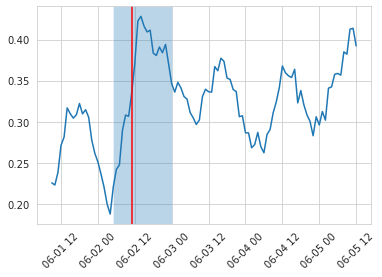

In [34]:
detector = CUSUMDetector(tsdata[:100])
change_points = detector.detector(threshold = 0.01 , return_all_changepoints=True, interest_window=[20,40])

detector.plot(change_points)
plt.xticks(rotation=45)
plt.show()


We can also access the changepoints detected by CUSUMDetector and all of their associated statistics.

In [35]:
change_points

[CUSUMChangePoint(start_time: 2022-06-02 11:00:00, end_time: 2022-06-02 11:00:00, confidence: 0.9999999998875596, direction: increase, index: 26, delta: 0.0705233600913322, regression_detected: True, stable_changepoint: True, mu0: 0.2712582864509364, mu1: 0.3417816465422686, llr: 45.81719608982343, llr_int: 29.592887596387957, p_value: 1.1244039033186937e-10, p_value_int: 3.7496100679934585e-07),
 CUSUMChangePoint(start_time: 2022-06-02 23:00:00, end_time: 2022-06-02 23:00:00, confidence: 0.8653122507973738, direction: decrease, index: 38, delta: 0.021038896430906784, regression_detected: False, stable_changepoint: True, mu0: 0.30990661249475576, mu1: 0.33094550892566255, llr: 4.009592296914933, llr_int: -0.09487366496110534, p_value: 0.13468774920262616, p_value_int: 1.0)]

Detecting Multiple Change Points with Interest Windows:

to detect multiple chagepoints, we'll iterate through the time series using a sliding window, and partition each sliding window into a historical window and a scan window. The length of each sliding window then will be historical_window + scan_window, where historical_window and scan_window are chosen suitably for the time series being considered. Run CUSUMDetector on the sliding window with the scan window as the interest window. Repeat and collect all changepoints until the sliding window reaches the end of the time series.


below we can see the change points for the positive sentiment score for the tweets about europe's energy crisis.

In [36]:
historical_window = 220
scan_window = 100
step = 5
changepoints = []
n = len(tsdata)
for end_idx in range(historical_window + scan_window, n, step):
    tsd = tsdata[end_idx - (historical_window + scan_window) : end_idx]
    changepoints += CUSUMDetector(tsd).detector(interest_window=[historical_window, historical_window + scan_window])

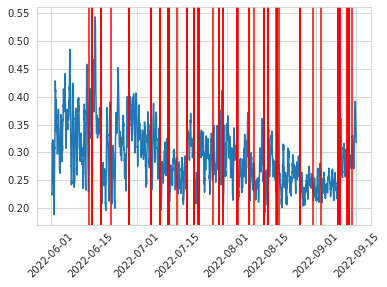

In [37]:
# plot the results
detector = CUSUMDetector(tsdata) # we are not really using this detector
detector.detector() # this call to detector is not being used for anything

detector.plot(changepoints)
plt.xticks(rotation=45)
plt.show()

### Robuststat detector

We can also leverage other algorithms like RobustStatDetector from kats to detect the change points in our time series data.

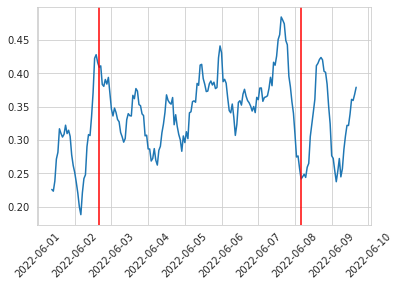

In [38]:
detector = RobustStatDetector(tsdata[:200])
changepoints = detector.detector(p_value_cutoff = 0.01, comparison_window=10)

# plot the results
detector.plot(changepoints)
plt.xticks(rotation=45)
plt.show()

# **Topic Modeling**

### ‘Which topic can frequently be found in these tweets?’

Now in this section we also want to go over all of our dataset and figure out the most importaint topics that are being discussed on twitter about the energy crisis and the workforce situation. We'll also cluter the tweets into different groups based on the topics they are about. This can be a great tool for buisness to get a better understanding of the topics that are being discussed on twitter and how they are related to each other.

In this part we'll add all of the tweets into a single dataframe and analyse them all together. 

Here we'll be using BERTopic.
BERTopic is a topic modeling technique that leverages huge transformers and c-TF-IDF to create dense clusters allowing for easily interpretable topics whilst keeping important words in the topic descriptions.

Here are the main steps for generating topics:
1. Preprocess the text
2. Create embeddings: we can use many different models to create semantic rich embeddings. We also have the option to use multilingual models to create embeddings for different languages.
3. Cluster the embeddings: We want to make sure that documents with similar topics are clustered together such that we can find the topics within these clusters.
to do this we first reduce the emebeddings dimensionality using UMAP and then cluster the embeddings using HDBSCAN.
4. Topic creation: We treat all documents in a single category (e.g., a cluster) as a single document and then apply TF-IDF. this technique is called c-TF-IDF. We then use the c-TF-IDF to find the most important words in each cluster. These words are then used to create the topic description.


In [20]:
timestamps = tweets_df.Datetime.to_list()
tweets = tweets_df.Text.to_list()

In [21]:
## checking some samples from the dataset
tweets[:5]

['vonderleyen Als France is manipulating the energy market by not connecting the MidCat pipe to the rest of Europe!MidCatFranceEUgasprijs',
 "ithaca666Boey_BomanVaushVAssBoss80085 *it's that the bosses want to maintain their workforce.",
 'randlight We have constrained production due to supply issues with China and Europe... the low interest rates did pump the housing market...but how can raising interest rates bring down energy costs!',
 'Workforce demographics and culture are changing. People Matters details how workspaces must stay ahead of the curve.  \n\nRead more here: hybridworkingofficespace',
 'Fostering a Diverse and Inclusive Cyber Workforce']

## Basic Topic Model



Fitting a model on our dataset of tweets about the energy crisis and the workforce situation. we'll set the nr_topics to 20 to make sure that we don't have too many topics.

In [ ]:
from bertopic import BERTopic
topic_model = BERTopic(min_topic_size=5, verbose=True, nr_topics=20)
# topic, _ = topic_model.fit(tweets)
topics, _ = topic_model.fit_transform(tweets)

Most frequent topics:

We can save our model for later use as well.

In [ ]:
topic_model.save("topic_model_europe_workforce_20topics")
# topic_model = topic_model.load("topic_model_europe_workforce_20topics")

Here are the most frequent topics.
We can already detect some interesting observations. 
For example the first and the most important topic seems to e the effect of russian source on european energy crisis. We can also see that the workforce layoff are also a big topic.

In [27]:
freq = topic_model.get_topic_info(); freq.head(10)

,Topic,Count,Name
0,-1,25140,-1_the_to_and_workforce
1,0,854,0_russia_energy_europe_russian
2,1,526,1_gas_gazprom_pipeline_nord
3,2,514,2_off_its_workforce_of
4,3,488,3_winter_energy_europe_will
5,4,468,4_nhs_care_workforce_social
6,5,458,5_the_brexit_uk_to
7,6,382,6_green_energy_europe_forests
8,7,370,7_talent_workforce_your_and
9,8,368,8_women_the_workforce_in


-1 refers to all outliers and should typically be ignored

Let's select a topic and check the words that are most important for that topic and their scores.
This one seems to be about layoff in tech companies.

In [31]:
topic_nr = freq.iloc[3]["Topic"]  # We select a frequent topic
topic_model.get_topic(topic_nr)   # You can select a topic number as shown above

[('off', 0.0919608972356176),
 ('its', 0.07733364936172155),
 ('workforce', 0.06703523526694607),
 ('of', 0.06343363188587296),
 ('shopify', 0.06239128125893985),
 ('robinhood', 0.05896171794094778),
 ('lays', 0.047682832798555515),
 ('laying', 0.045863330429917984),
 ('snap', 0.04500412589742953),
 ('cuts', 0.041168490370478324)]

Visualize the basic topics that were created with the Intertopic Distance Map. This allows us to judge visually whether the basic topics are sufficient before proceeding to creating the topics over time. 

it also gives a better understanding about the relationship between the topics and how they are related to each other.

We can already seem some meaningful clusters in the plot below.

In [34]:
fig = topic_model.visualize_topics(); fig

## Topics over Time
Now let's check how the topics that were defined previously have evolved over time. 

Important parameters:

* `docs`
  * These are the tweets that we are using
* `topics`
  * The topics that we have created before
* `timestamps`
  * The timestamp of each tweet/document
* `global_tuning`
  * Whether to average the topic representation of a topic at time *t* with its global topic representation
* `evolution_tuning`
  * Whether to average the topic representation of a topic at time *t* with the topic representation of that topic at time *t-1*
* `nr_bins`
  * The number of bins to put our timestamps into. It is computationally inefficient to extract the topics at thousands of different timestamps. Therefore, it is advised to keep this value below 20. 


In [36]:
topics_over_time = topic_model.topics_over_time(docs=tweets, 
                                                # topics=topics, 
                                                timestamps=timestamps, 
                                                global_tuning=True, 
                                                evolution_tuning=True, 
                                                nr_bins=20)

20it [00:06,  3.29it/s]


## Visualize Topics over Time



After creating topics over time with Dynamic Topic Modeling, we can visualize these topics by leveraging the interactive abilities of Plotly. When hovering over the points, Plotly displays the frequency of topics over time while providing a time-specific representation of each topic.

It's intersting to see how the topics have evolved over time. We can see that the topic about the russian influence on the energy crisis has been the most important topic for a long time. We can also see the emergence of concerns regarding energy situation in winter. Remote working is also a big topic that has been discussed a lot in the last few months.

In [37]:
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=20)

## Hierarchical Topic Modeling


 In order to understand the potential hierarchical structure of the topics, we can use scipy.cluster.hierarchy to create clusters and visualize how they relate to one another. This might help selecting an appropriate nr_topics when reducing the number of topics

In [38]:

docs = tweets


In [42]:
from scipy.cluster import hierarchy as sch


# Hierarchical topics
hierarchical_topics = topic_model.hierarchical_topics(docs)

100%|██████████| 19/19 [00:00<00:00, 161.81it/s]


In [43]:
hierarchical_topics

,Parent_ID,Parent_Name,Topics,Child_Left_ID,Child_Left_Name,Child_Right_ID,Child_Right_Name,Distance
18,38,the_energy_to_of_europe,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",34,energy_europe_to_the_russia,37,workforce_the_of_to_and,2.954374
17,37,workforce_the_of_to_and,"[2, 4, 5, 7, 8, 9, 10, 16, 18, 19]",36,workforce_the_of_to_and,16,honoring_american_wishing_labor_safe,1.906998
16,36,workforce_the_of_to_and,"[2, 4, 5, 7, 8, 9, 10, 18, 19]",35,workforce_the_to_and_of,2,off_its_workforce_of_shopify,1.327945
15,35,workforce_the_to_and_of,"[4, 5, 7, 8, 9, 10, 18, 19]",33,workforce_remote_to_and_diversity,32,the_workforce_of_nhs_to,1.236672
14,34,energy_europe_to_the_russia,"[0, 1, 3, 6, 11, 12, 13, 14, 15, 17]",1,gas_gazprom_pipeline_nord_energy,31,energy_europe_to_the_is,1.163051
13,33,workforce_remote_to_and_diversity,"[7, 10, 19]",19,remote_to_workforce_work_your,25,diversity_workforce_diverse_and_to,1.010756
12,32,the_workforce_of_nhs_to,"[4, 5, 8, 9, 18]",24,nhs_health_workforce_care_the,30,the_women_workforce_covid_of,0.988163
11,31,energy_europe_to_the_is,"[0, 3, 6, 11, 12, 13, 14, 15, 17]",27,energy_nuclear_green_europe_the,28,energy_europe_russia_to_the,0.955889
10,30,the_women_workforce_covid_of,"[5, 8, 18]",29,women_the_workforce_in_of,18,covid_long_the_workforce_of,0.906783
9,29,women_the_workforce_in_of,"[5, 8]",5,the_brexit_uk_to_workforce,8,women_the_workforce_in_men,0.870110


In [45]:
tree = topic_model.get_topic_tree(hierarchical_topics)
print(tree)

.
├─energy_europe_to_the_russia
│    ├─■──gas_gazprom_pipeline_nord_energy ── Topic: 1
│    └─energy_europe_to_the_is
│         ├─energy_nuclear_green_europe_the
│         │    ├─■──nuclear_energy_power_france_plant ── Topic: 11
│         │    └─green_energy_europe_renewable_is
│         │         ├─■──green_energy_europe_forests_is ── Topic: 6
│         │         └─■──solar_renewable_energy_wind_europe ── Topic: 13
│         └─energy_europe_russia_to_the
│              ├─winter_energy_europe_prices_in
│              │    ├─■──winter_energy_europe_will_this ── Topic: 3
│              │    └─■──prices_europe_energy_in_calculus ── Topic: 12
│              └─energy_europe_russia_russian_to
│                   ├─energy_russia_europe_russian_the
│                   │    ├─■──germany_energy_german_europe_the ── Topic: 17
│                   │    └─russia_energy_europe_russian_ukraine
│                   │         ├─■──russia_energy_europe_russian_sanctions ── Topic: 0
│                   │  

In [51]:

topic_model.visualize_hierarchical_documents(docs, hierarchical_topics)

Here is another visualization of the topics and the associated words that are most important for each topic.

In [47]:
topic_model.visualize_barchart()


Having generated topic embeddings, through both c-TF-IDF and embeddings, we can create a similarity matrix by simply applying cosine similarities through those topic embeddings. The result will be a matrix indicating how similar certain topics are to each other.

In [48]:
topic_model.visualize_heatmap()


In order to represent topics, a number of words are used, starting with the best representative word. Each word is represented by a c-TF-IDF score. Words with a higher score are more representative of the topic. With each new word added, the scores slowly decline since the topic words are sorted by their c-TF-IDF scores.
To visualize this effect, we can plot the c-TF-IDF scores for each topic by the term rank of each word. In other words, the position of the words (term rank), where the words with the highest c-TF-IDF score will have a rank of 1, will be put on the x-axis. Whereas the y-axis will be populated by the c-TF-IDF scores. The result is a visualization that shows you the decline of c-TF-IDF score when adding words to the topic representation. It allows us, using the elbow method, the select the best number of words in a topic.

In [49]:
topic_model.visualize_term_rank()


We can also use the log scale on the y-axis for a better view of individual topics,

In [50]:
topic_model.visualize_term_rank(log_scale=True)


## Conclusion

In this Blog post we have seen that how we can use several machine learning techniques to analyse the tweets about certain topics and how to extract insight from them. We believe it's very importat that buisnesses and companies have access to these insights in advenced so they can make well informed decisions. It can be on the product development lifecycle where you try to understand what your customers are talking about or it can be on the marketing side where you want to understand what your competitors are doing.
Or it can be on different stages of marketing campaigns where you want to understand how your customers are reacting to your marketing campaigns. or created more targeted content. 
It can be used in HR to understand what the employees are talking about and how they are feeling about the company, work environment and how it can be improved.
The list of use cases is endless and we hope that this blog post we've shown you just some possibilities.

We at Centa MG are always looking for new ways to help our customers to make better, more insightfulf and data centric decision. If you have any questions or want to know more about our services, please feel free to contact us!